## CS3570 Introduction to Multimedia Technology
### Homework 04 Due: 11:59pm, 2025/05/16

### Reminder:
* **You are not allowed to import any library in your Jupyter Notebook file except for those we provide.**
* **Your code must display and output your results to enable us to verify its correctness.**
* **Please follow the instructions in the Jupyter Notebook and complete the parts marked as `"TODO."`**
* **Please include your report in the Jupyter Notebook using markdown.**
* **Please compress your code, input images, and result images in a zip file named HW4_{StudentID}.zip and upload it to eeclass.**
* **Homework should be submitted before the announced due time. Scores of late homework will be reduced by 20% per day.**
* **If you encounter any problems or have questions, please post them on eeclass.**

## Part 1: Bezier Curve (30%)

In [1]:
import numpy as np
import cv2
import os
import matplotlib.pyplot as plt

In [2]:
# Utility functions
def draw_subplot(points , result1 , result2 , img):
    plt.imshow(img)
    plt.scatter(points[:, 0], points[:, 1],  s=2, color='blue')
    plt.plot(result1[:, 0], result1[:, 1], linewidth=0.8, color='cyan')

    plt.plot(result2[:, 0], result2[:, 1], linewidth=0.8, color='magenta')
    plt.savefig('output/1a.png', dpi=200, bbox_inches='tight')
    plt.show()


def draw_plot(points , result , img):
    plt.imshow(img)
    plt.scatter(points[:, 0], points[:, 1],  s=5, color='blue')
    plt.plot(result[:, 0], result[:, 1], linewidth=1, color='magenta')
    plt.savefig('output/1b.png', dpi=200, bbox_inches='tight')
    plt.show()

In [3]:
# TODO: Implement Bézier curves calculation. You may adjust the function parameters if needed.
def bezier_curve(points , step):
    num_points = len(points)
    
    # Check if we can create at least one cubic Bézier curve
    if num_points < 4 or (num_points - 1) % 3 != 0:
        raise ValueError("Number of points must be 3k+1 where k is the number of cubic Bézier curves")
    
    num_curves = (num_points - 1) // 3
    result = []
    
    for i in range(num_curves):
        # Get the 4 control points for this curve segment
        p0 = points[i * 3]
        p1 = points[i * 3 + 1]
        p2 = points[i * 3 + 2]
        p3 = points[i * 3 + 3]
        
        # Calculate points on the curve using the parameter t
        t_values = np.arange(0, 1 + step, step)
        if i < num_curves - 1:  # For all but the last curve, exclude t=1 to avoid duplicates
            t_values = t_values[t_values < 1]
        
        for t in t_values:
            # Cubic Bézier formula: B(t) = (1-t)³P₀ + 3(1-t)²tP₁ + 3(1-t)t²P₂ + t³P₃
            point = (1-t)**3 * p0 + 3*(1-t)**2*t * p1 + 3*(1-t)*t**2 * p2 + t**3 * p3
            result.append(point)
    
    return np.array(result)

# TODO: Scale up the image. You may adjust the function parameters if needed.
def nearest_inter(img):
    height, width = img.shape[:2]
    scale_factor = 4
    # Use NumPy's repeat to duplicate rows and columns
    if len(img.shape) == 3:  # Color image
        # Repeat each row scale_factor times
        scaled_img = np.repeat(img, scale_factor, axis=0)
        # Repeat each column scale_factor times
        scaled_img = np.repeat(scaled_img, scale_factor, axis=1)
    else:  # Grayscale image
        scaled_img = np.repeat(np.repeat(img, scale_factor, axis=0), scale_factor, axis=1)
    
    return scaled_img


### 1a. "Implement the cubic Bézier curve calculation

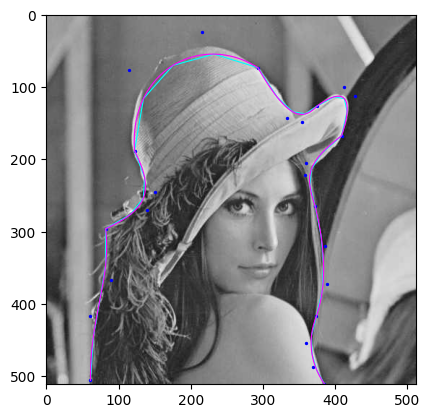

In [4]:
img = cv2.imread("./bg.png")
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
points = np.loadtxt("./points.txt")

# TODO: You shold replace result1 , result2 with low-detail and high-detail curve results return by function bezier_curve()

result1 = bezier_curve(points, step=0.25) # low-detail curves
result2 = bezier_curve(points, step=0.001) # high-detail curves

if not os.path.exists('output'):
    os.makedirs('output')

draw_subplot(points  , result1 , result2 , img)

### 1b. Scale up the image and the curves by 4 times

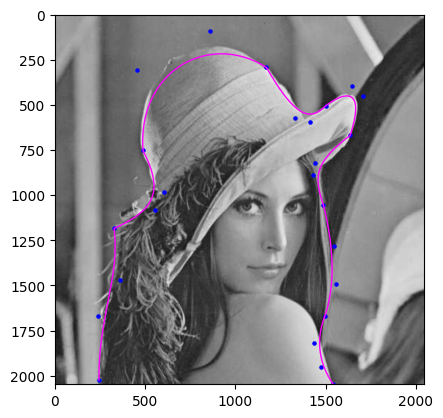

In [5]:
# TODO: Scale up the image and the bezier curve

scale_img = nearest_inter(img)
scale_points = points * 4  # Scale the control points
scale_result = bezier_curve(scale_points, step=0.001)  # Use high-detail for the scaled version

draw_plot(scale_points , scale_result , scale_img)

## Part 2. 3D Models

In [6]:
# download the packages
! pip install meshio
! pip install plotly
! pip install chart-studio
# for writing the image of plotly
! pip install kaleido
! pip install ipykernel
! pip install --upgrade nbformat

Defaulting to user installation because normal site-packages is not writeable

[notice] A new release of pip is available: 23.0.1 -> 25.1.1
[notice] To update, run: /Library/Developer/CommandLineTools/usr/bin/python3 -m pip install --upgrade pip
Defaulting to user installation because normal site-packages is not writeable

[notice] A new release of pip is available: 23.0.1 -> 25.1.1
[notice] To update, run: /Library/Developer/CommandLineTools/usr/bin/python3 -m pip install --upgrade pip
Defaulting to user installation because normal site-packages is not writeable

[notice] A new release of pip is available: 23.0.1 -> 25.1.1
[notice] To update, run: /Library/Developer/CommandLineTools/usr/bin/python3 -m pip install --upgrade pip
Defaulting to user installation because normal site-packages is not writeable

[notice] A new release of pip is available: 23.0.1 -> 25.1.1
[notice] To update, run: /Library/Developer/CommandLineTools/usr/bin/python3 -m pip install --upgrade pip
Defaulting to us

In [7]:
# Import the necessaries libraries
import meshio
import plotly.offline as py
import plotly.graph_objs as go
import plotly.io as pio
import plotly.subplots as sp

# Set notebook mode to work in offline
#py.init_notebook_mode()
#pio.renderers.default = 'iframe'
#If you can't correctly show the 3D rendering try uncommenting the above 2 lines

### Load the bunny object

In [8]:
msh = meshio.read("bunny.obj")
verts = msh.points
x, y, z = verts.T
I, J, K =  msh.cells_dict["triangle"].T

In [9]:
colorscale = [[0, 'rgb(255,192,203)'],
              [1, 'rgb(255,192,203)']]

In [10]:
trace = go.Mesh3d(x=x, y=y, z=z,
                i=I, j=J, k=K,
                intensity=z,
                colorscale =colorscale,
                showscale=False)

py.iplot([trace])

### 2a. Shift the center of the bunny to (0, 0, 0)

In [11]:
# TODO: Implement the translation

# Calculate the current center of the bunny
center_x = (np.max(x) + np.min(x)) / 2
center_y = (np.max(y) + np.min(y)) / 2
center_z = (np.max(z) + np.min(z)) / 2

# Translate vertices to center at origin
x_center = x - center_x
y_center = y - center_y
z_center = z - center_z

trace = go.Mesh3d(x=x_center, y=y_center, z=z_center,
                i=I, j=J, k=K,
                intensity=z,
                colorscale =colorscale,
                showscale=False)
py.iplot([trace])

fig = go.Figure([trace])
fig.add_trace(trace)
fig.write_image("output/2a.png", scale=2)

### 2b. Rotate the bunny to face the screen

In [12]:
# TODO: Implement the rotation

# Define rotation matrices
def rotation_matrix_x(angle_degrees):
    """Create rotation matrix for rotation around x-axis"""
    angle_radians = np.radians(angle_degrees)
    cos_theta = np.cos(angle_radians)
    sin_theta = np.sin(angle_radians)
    
    return np.array([
        [1, 0, 0],
        [0, cos_theta, -sin_theta],
        [0, sin_theta, cos_theta]
    ])

def rotation_matrix_y(angle_degrees):
    """Create rotation matrix for rotation around y-axis"""
    angle_radians = np.radians(angle_degrees)
    cos_theta = np.cos(angle_radians)
    sin_theta = np.sin(angle_radians)
    
    return np.array([
        [cos_theta, 0, sin_theta],
        [0, 1, 0],
        [-sin_theta, 0, cos_theta]
    ])
# Combine the centered points into a single matrix
centered_points = np.column_stack((x_center, y_center, z_center))

# Create combined rotation matrix
# First rotate -90 degrees around x-axis to make bunny upright
rotation_x = rotation_matrix_x(-90)
# Then rotate 180 degrees around y-axis to make bunny face forward
rotation_y = rotation_matrix_y(180)

# Apply rotations in sequence (first x, then y)
rotated_points = np.dot(centered_points, rotation_x.T)
rotated_points = np.dot(rotated_points, rotation_y.T)

# Extract the rotated coordinates
x_rotate, y_rotate, z_rotate = rotated_points.T

trace = go.Mesh3d(x=x_rotate, y=y_rotate, z=z_rotate,
                i=I, j=J, k=K,
                intensity=z,
                colorscale=colorscale,
                showscale=False)
py.iplot([trace])

fig = go.Figure([trace])
fig.write_image("output/2b.png", scale=2)

### 2c. 3D Lighting



### Create a spherical surface and map a moon texture onto it

In [13]:
import plotly.graph_objects as go

# Create a sphere surface with moon texture, we've already finished this part for you.
# grid resolution
n_phi, n_theta = 180, 360

# build sphere coords
theta, phi = np.meshgrid(
    np.linspace(0, 2*np.pi, n_theta),
    np.linspace(0, np.pi,   n_phi),
)
x = np.sin(phi)*np.cos(theta)
y = np.sin(phi)*np.sin(theta)
z = np.cos(phi)

# load + resize grayscale map
img = cv2.imread("moon.png", cv2.IMREAD_GRAYSCALE)
img = cv2.resize(img, (n_theta, n_phi))
surfacecolor = img.astype(float) / 255.0
# move the zero‐longitude seam to the back
surfacecolor = np.roll(surfacecolor, n_theta//2, axis=1)

# plot
common_lightpos = dict(x=100, y=200, z=0)
fig = go.Figure(go.Surface(
    x=x, y=y, z=z,
    surfacecolor=surfacecolor,
    colorscale="gray",
    lightposition=common_lightpos,
    showscale=False
))
fig.update_layout(
    scene=dict(aspectmode="data"),
    margin=dict(l=0, r=0, t=0, b=0)
)
fig.show()

### Try different lighting settings

In [ ]:
from plotly.subplots import make_subplots

# TODO: Compare different ambient, diffuse and specular lighting settings.
#       reference: https://plotly.com/python/v3/3d-surface-lighting/
#2c_1. Ambient light
fig = make_subplots(
    rows=1, cols=2,
    specs=[[{'type': 'surface'}, {'type': 'surface'}]])
# low ambient light 0.3, 0.3, 0.05
trace1 = (go.Surface(
    x=x, y=y, z=z,
    surfacecolor=surfacecolor,
    colorscale="gray",
    lighting=dict(ambient=0.3, diffuse=0.3, specular=0.05, roughness=0.5, fresnel=0.2),
    lightposition=common_lightpos,
    showscale=False
))
# high ambient light 0.8, 0.3, 0.05
trace2 = (go.Surface(
    x=x, y=y, z=z,
    surfacecolor=surfacecolor,
    colorscale="gray",
    lighting=dict(ambient=0.8, diffuse=0.3, specular=0.05, roughness=0.5, fresnel=0.2),
    lightposition=common_lightpos,
    showscale=False
))


fig.add_trace(trace1, row=1,col=1)
fig.add_trace(trace2, row=1,col=2)

fig.write_image("output/2c_1.png", scale=2)
fig.show()

# 2c_2. Diffuse light
fig = make_subplots(
    rows=1, cols=2,
    specs=[[{'type': 'surface'}, {'type': 'surface'}]])
# low diffuse light 0.3, 0.4, 0.05
trace1 = (go.Surface(
    x=x, y=y, z=z,
    surfacecolor=surfacecolor,
    colorscale="gray",
    lighting=dict(ambient=0.3, diffuse=0.4, specular=0.05, roughness=0.5, fresnel=0.2),
    lightposition=common_lightpos,
    showscale=False
))
# high diffuse light 0.3, 0.95, 0.05
trace2 = (go.Surface(
    x=x, y=y, z=z,
    surfacecolor=surfacecolor,
    colorscale="gray",
    lighting=dict(ambient=0.3, diffuse=0.95, specular=0.05, roughness=0.5, fresnel=0.2),
    lightposition=common_lightpos,
    showscale=False
))

fig.add_trace(trace1, row=1,col=1)
fig.add_trace(trace2, row=1,col=2)

fig.write_image("output/2c_2.png", scale=2)
fig.show()

# 2c_3. Specular light
fig = make_subplots(
    rows=1, cols=2,
    specs=[[{'type': 'surface'}, {'type': 'surface'}]])
# low specular light 0.3, 0.8, 0.3
trace1 = (go.Surface(
    x=x, y=y, z=z,
    surfacecolor=surfacecolor,
    colorscale="gray",
    lighting=dict(ambient=0.3, diffuse=0.8, specular=0.3, roughness=0.5, fresnel=0.2),
    lightposition=common_lightpos,
    showscale=False
))
# high specular light 0.3, 0.8, 0.5
trace2 = (go.Surface(
    x=x, y=y, z=z,
    surfacecolor=surfacecolor,
    colorscale="gray",
    lighting=dict(ambient=0.3, diffuse=0.8, specular=0.5, roughness=0.5, fresnel=0.2),
    lightposition=common_lightpos,
    showscale=False
))

fig.add_trace(trace1, row=1,col=1)
fig.add_trace(trace2, row=1,col=2)

fig.write_image("output/2c_3.png", scale=2)
fig.show()

## Part 3. Report